In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
df = pd.read_csv('/Users/franckatteaka/Desktop/cours/Semester III/ML_for_finance/Data/data_clean.csv',sep = ",",parse_dates = True,index_col = 0 )

In [3]:
df.head()

,s_eu,s_ch,kof_baro,kof_mpc,1J,2J,3J,4J,5J,6J,7J,8J,9J,10J,15J,20J,30J
Date,,,,,,,,,,,,,,,,,
2007-04-02,112.3,117.499994,101.798591,0.176471,0.02412,0.02402,0.02414,0.02462,0.02521,0.02574,0.02619,0.02656,0.02686,0.02710,0.02784,0.02821,0.02858
2007-04-03,112.3,117.499994,101.798591,0.176471,0.02414,0.02420,0.02441,0.02490,0.02546,0.02595,0.02636,0.02670,0.02697,0.02718,0.02784,0.02818,0.02851
2007-04-04,112.3,117.499994,101.798591,0.176471,0.02431,0.02430,0.02448,0.02498,0.02553,0.02603,0.02644,0.02677,0.02704,0.02725,0.02791,0.02824,0.02856
2007-04-05,112.3,117.499994,101.798591,0.176471,0.02439,0.02425,0.02449,0.02506,0.02568,0.02621,0.02663,0.02697,0.02724,0.02746,0.02812,0.02845,0.02878
2007-04-10,112.3,117.499994,101.798591,0.176471,0.02441,0.02444,0.02477,0.02538,0.02600,0.02653,0.02694,0.02727,0.02754,0.02775,0.02839,0.02871,0.02903


In [4]:
df.iloc[:,0:4] = df.iloc[:,0:4].apply(lambda x: x/(10 * x.max())).copy()

In [5]:
df.head()

,s_eu,s_ch,kof_baro,kof_mpc,1J,2J,3J,4J,5J,6J,7J,8J,9J,10J,15J,20J,30J
Date,,,,,,,,,,,,,,,,,
2007-04-02,0.097908,0.099382,0.077428,0.025668,0.02412,0.02402,0.02414,0.02462,0.02521,0.02574,0.02619,0.02656,0.02686,0.02710,0.02784,0.02821,0.02858
2007-04-03,0.097908,0.099382,0.077428,0.025668,0.02414,0.02420,0.02441,0.02490,0.02546,0.02595,0.02636,0.02670,0.02697,0.02718,0.02784,0.02818,0.02851
2007-04-04,0.097908,0.099382,0.077428,0.025668,0.02431,0.02430,0.02448,0.02498,0.02553,0.02603,0.02644,0.02677,0.02704,0.02725,0.02791,0.02824,0.02856
2007-04-05,0.097908,0.099382,0.077428,0.025668,0.02439,0.02425,0.02449,0.02506,0.02568,0.02621,0.02663,0.02697,0.02724,0.02746,0.02812,0.02845,0.02878
2007-04-10,0.097908,0.099382,0.077428,0.025668,0.02441,0.02444,0.02477,0.02538,0.02600,0.02653,0.02694,0.02727,0.02754,0.02775,0.02839,0.02871,0.02903


In [6]:
def sub_range(df,nb_years = None):

    last = df.index.date.max()
    first =  last.replace(year = last.year - nb_years)
    df2 = df[ df.index.date >= first].copy()

    return df2
    
def yields_plot(df):
    
    terms = ['1J', '2J','3J', '4J', '5J', '6J','7J', '8J', '9J', '10J', '15J', '20J', '30J']

    figure, axes = plt.subplots(3,1,figsize=(15,12))
    plt.figure(figsize = (10,6))
    df.loc[:,terms].plot(ax=axes[0])
    df.loc[:,df.columns.str.contains('s_')].plot(ax=axes[1])
    df.loc[:,df.columns.str.contains('kof')].plot(ax=axes[2])
    plt.show()




    #df[ df.index.date >= first].loc[:,terms[pos[0]:pos[1]]].plot(figsize = (15,8)).plot()
    #df[ df.index.date >= first].iloc[:,0:4].plot(figsize = (15,8)).plot()
    


In [7]:
def sign(series):
    l = list(series.values)
    res =np.array([*map(lambda x: 1 if x >0 else( -1 if x<0 else 0),l)] )
    return res

In [8]:
 a = sign(df['kof_mpc'])

In [9]:
np.where(a == -1)

(array([ 398,  399,  400, ..., 3341, 3342, 3343]),)

# Yields and economic factors plots 

## Full data range

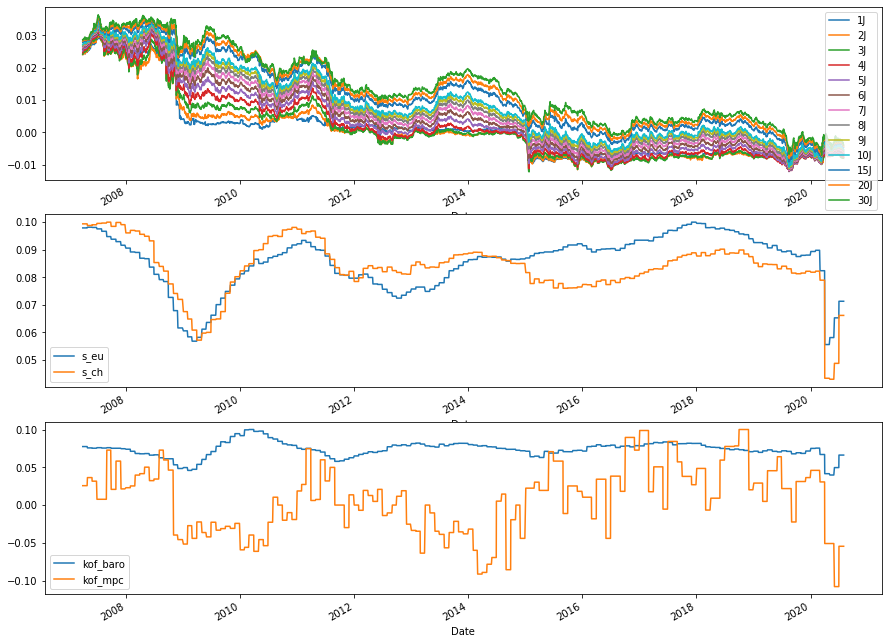

<Figure size 720x432 with 0 Axes>

In [10]:
yields_plot(df)

<Figure size 864x720 with 0 Axes>

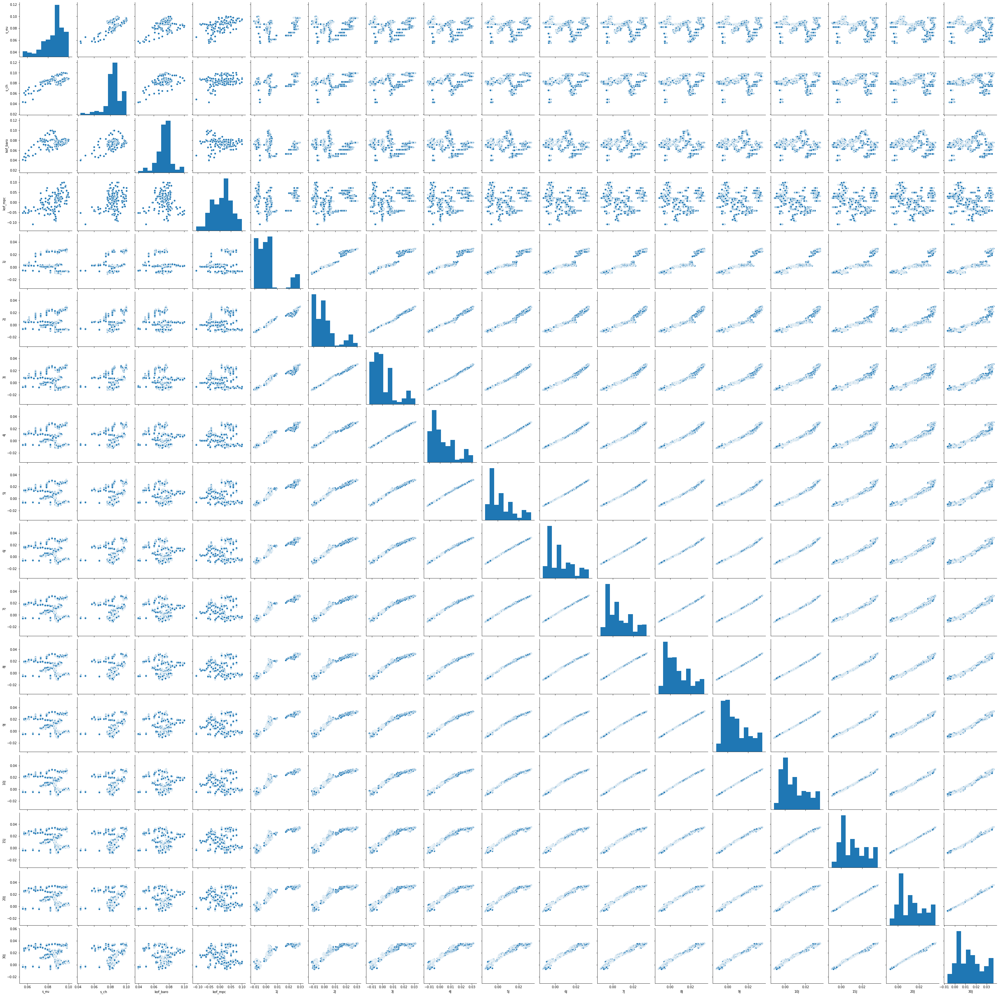

In [11]:
plt.figure(figsize = (12,10))
sns.pairplot(df)

## Last 5 years of data

In [12]:
# number of years we want to plot
df_5year = sub_range(df,nb_years = 5)

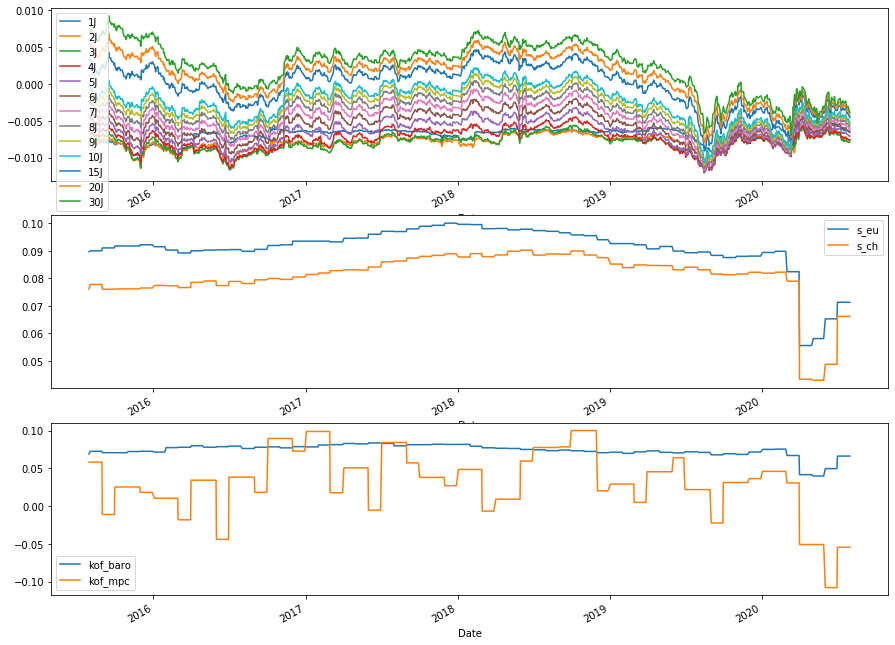

<Figure size 720x432 with 0 Axes>

In [13]:
yields_plot(df_5year)

<Figure size 864x720 with 0 Axes>

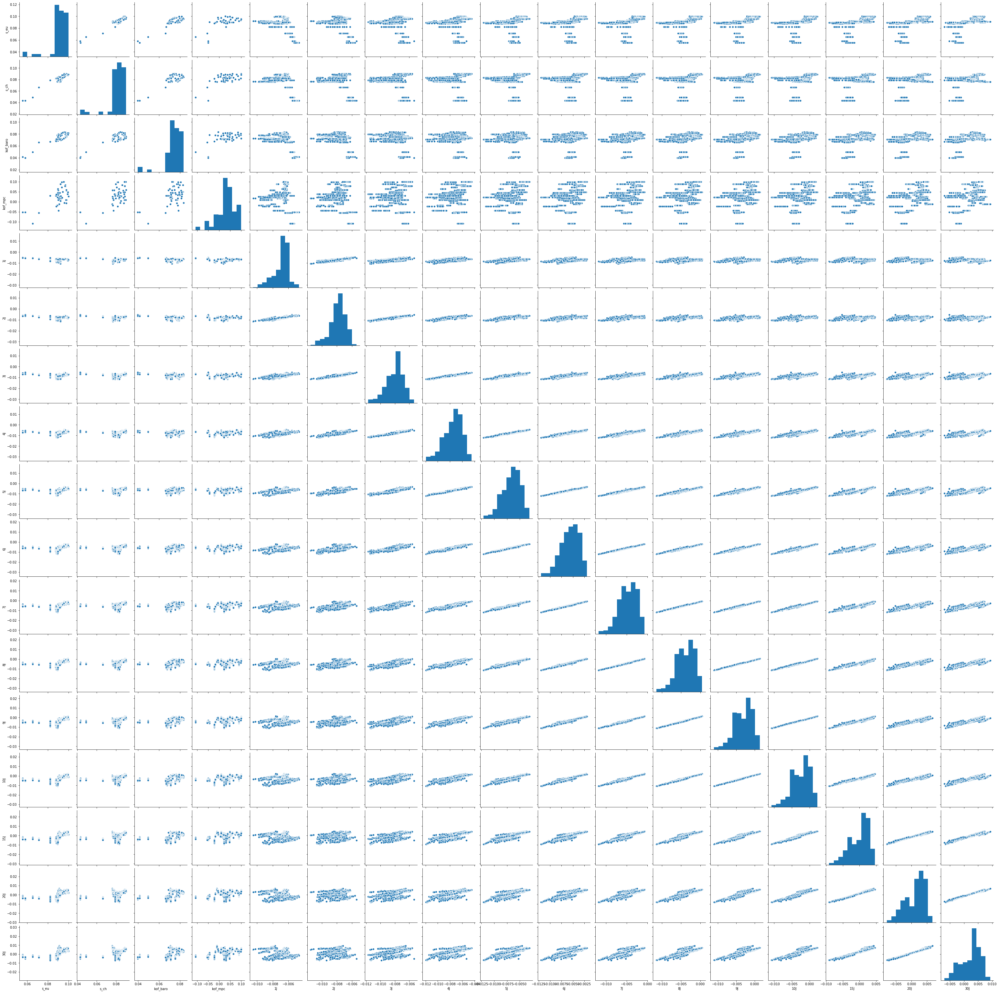

In [14]:
plt.figure(figsize = (12,10))
sns.pairplot(df_5year)

In [15]:
def rolling_diff(df,freq):
    df2 = (df.iloc[:,0:4].rolling(freq).apply(lambda x: x.iloc[-1] - x.iloc[0]).copy()).dropna()
    return df2.join(df.iloc[:,4:])   
def rolling_vol(df,freq):
    df2 = (df.iloc[:,0:4].rolling(freq).std().copy()).dropna()
    return df2.join(df.iloc[:,4:])   
    
def rolling_mean(df,freq):
    df2 = (df.iloc[:,0:4].rolling(freq).mean().copy()).dropna()
    return df2.join(df.iloc[:,4:])   

def rolling_max(df,freq):
    df2 = (df.iloc[:,0:4].rolling(freq).max().copy()).dropna()
    return df2.join(df.iloc[:,4:])   

def rolling_min(df,freq):
    df2 = (df.iloc[:,0:4].rolling(freq).min().copy()).dropna()
    return df2.join(df.iloc[:,4:])   

def rolling_growth(df,freq):
    df2 = (df.iloc[:,0:4].rolling(freq).apply(lambda x: (x.iloc[-1] - x.iloc[0])/x.iloc[0]).copy()).dropna()
    return df2.join(df.iloc[:,4:])   


### Rolling differences

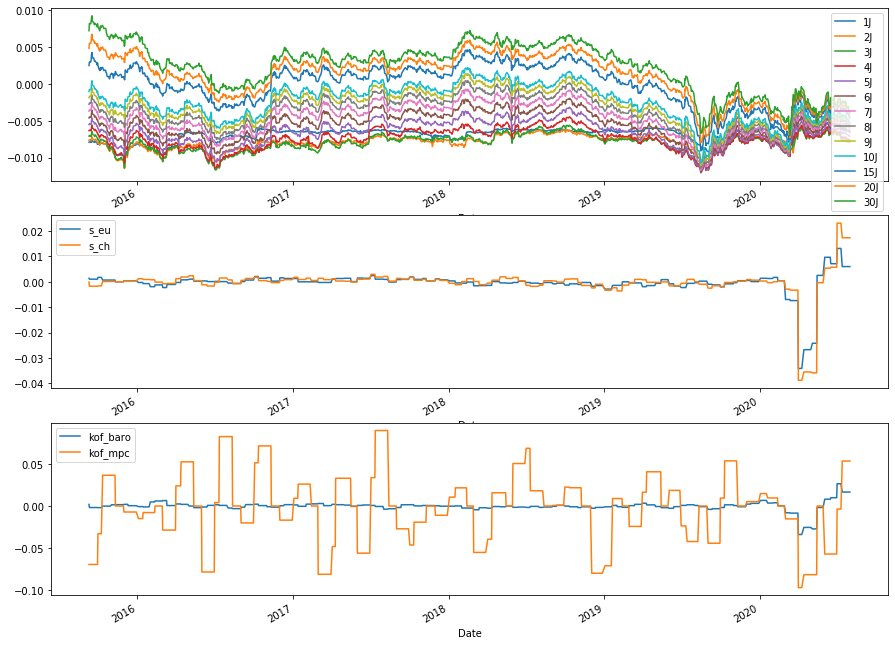

<Figure size 720x432 with 0 Axes>

In [16]:
yields_plot(rolling_diff(df_5year,30))

<Figure size 864x720 with 0 Axes>

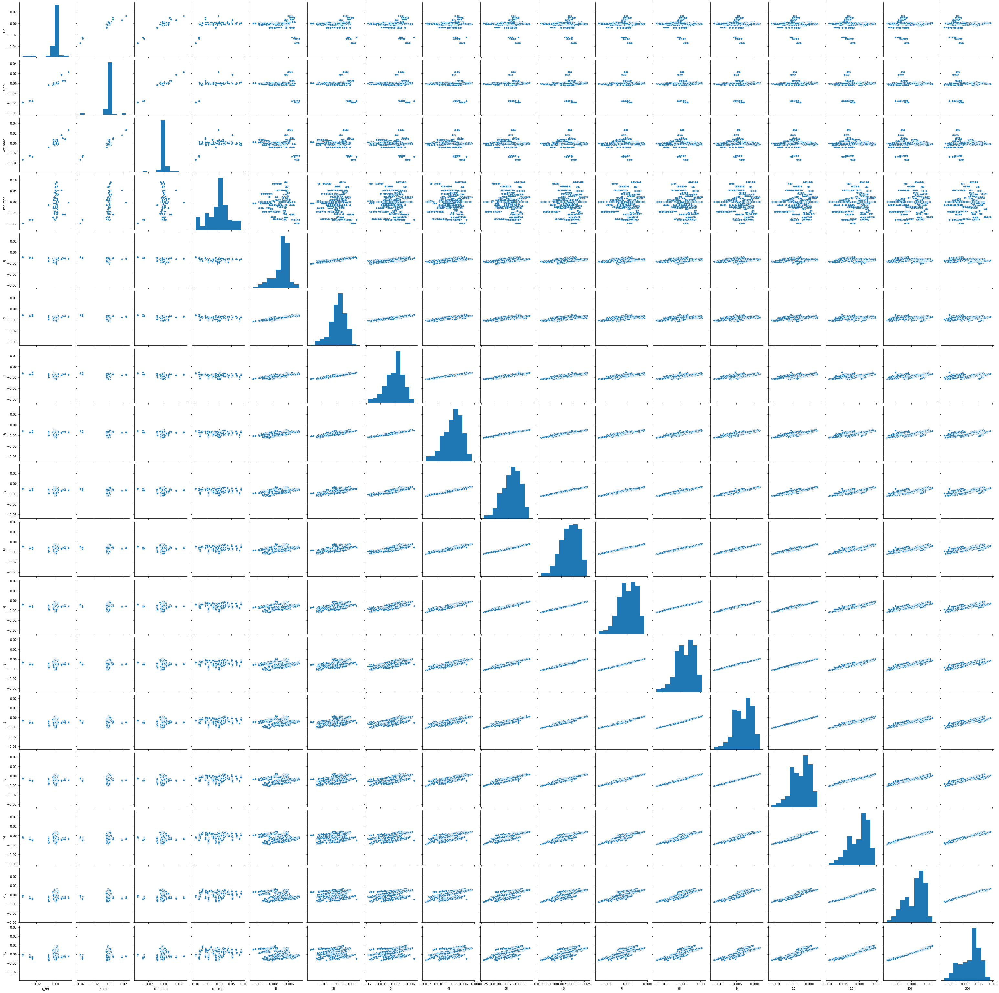

In [17]:
plt.figure(figsize = (12,10))
sns.pairplot(rolling_diff(df_5year,30))

### Rolling growth

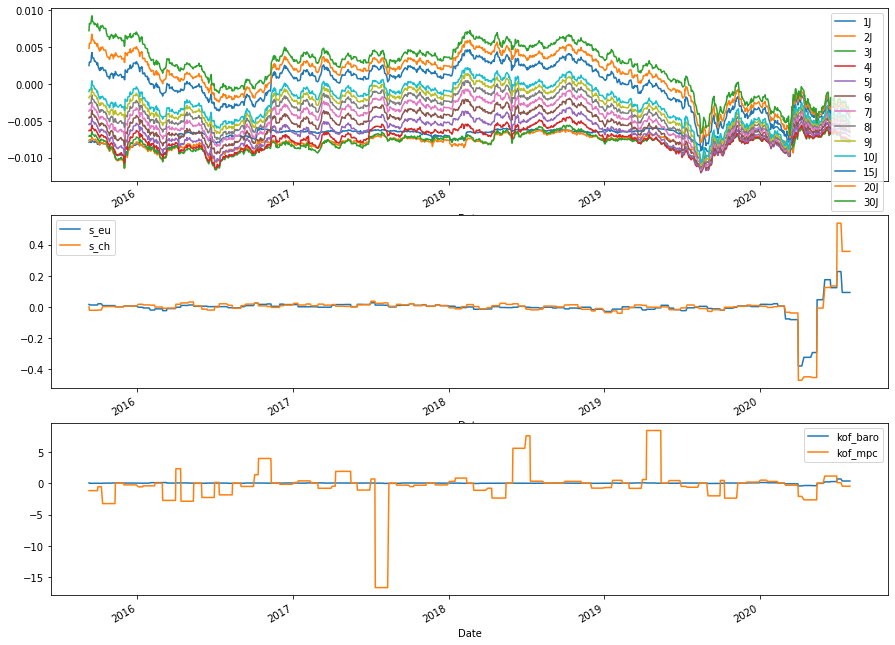

<Figure size 720x432 with 0 Axes>

In [18]:
yields_plot(rolling_growth(df_5year,30))

<Figure size 864x720 with 0 Axes>

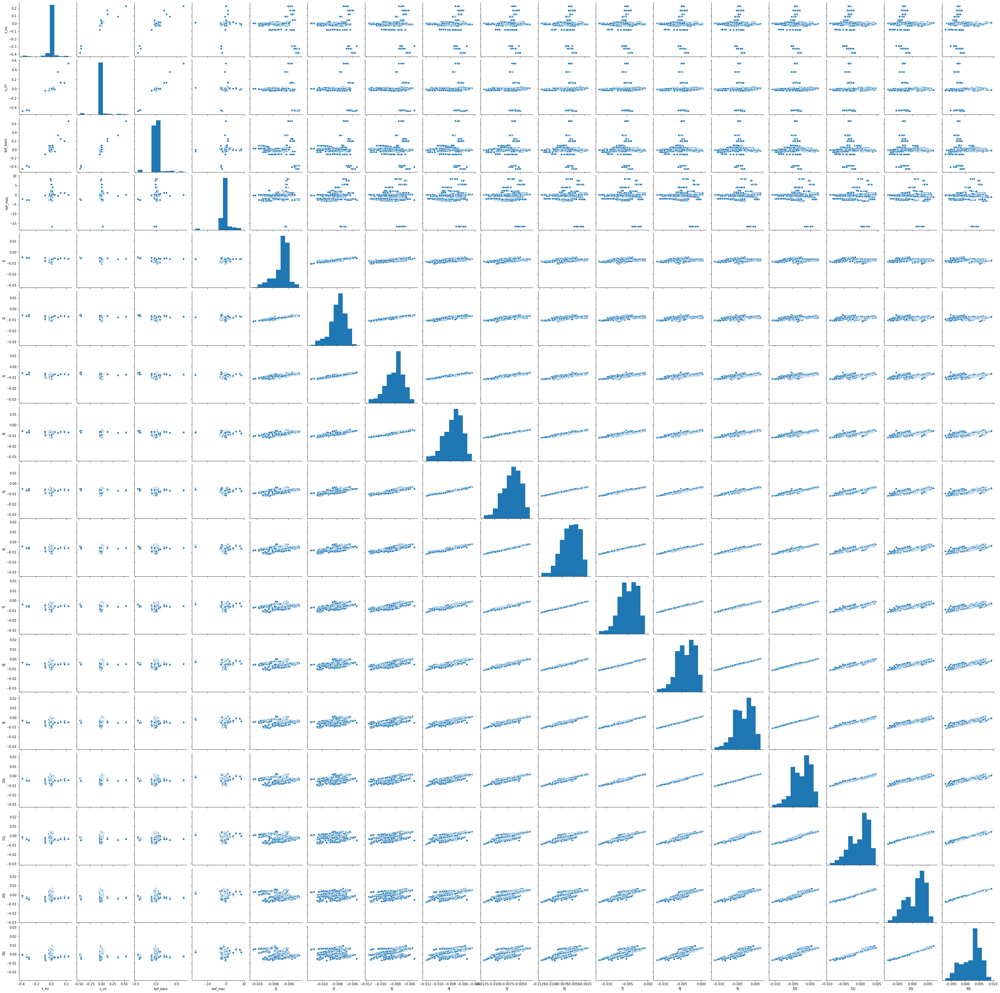

In [19]:
plt.figure(figsize = (12,10))
sns.pairplot(rolling_growth(df_5year,30))

### Rolling vol

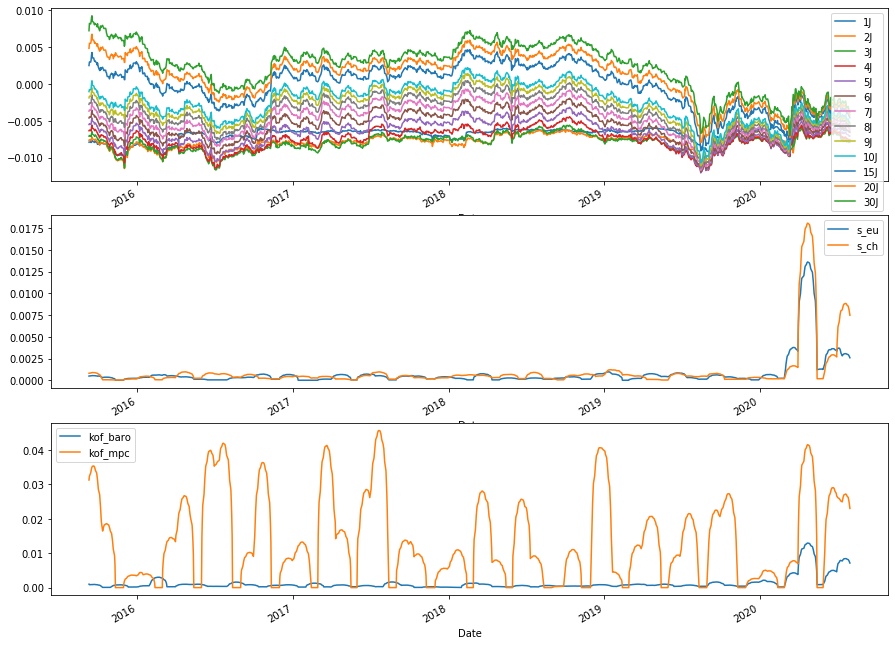

<Figure size 720x432 with 0 Axes>

In [20]:
yields_plot(rolling_vol(df_5year,30))

<Figure size 864x720 with 0 Axes>

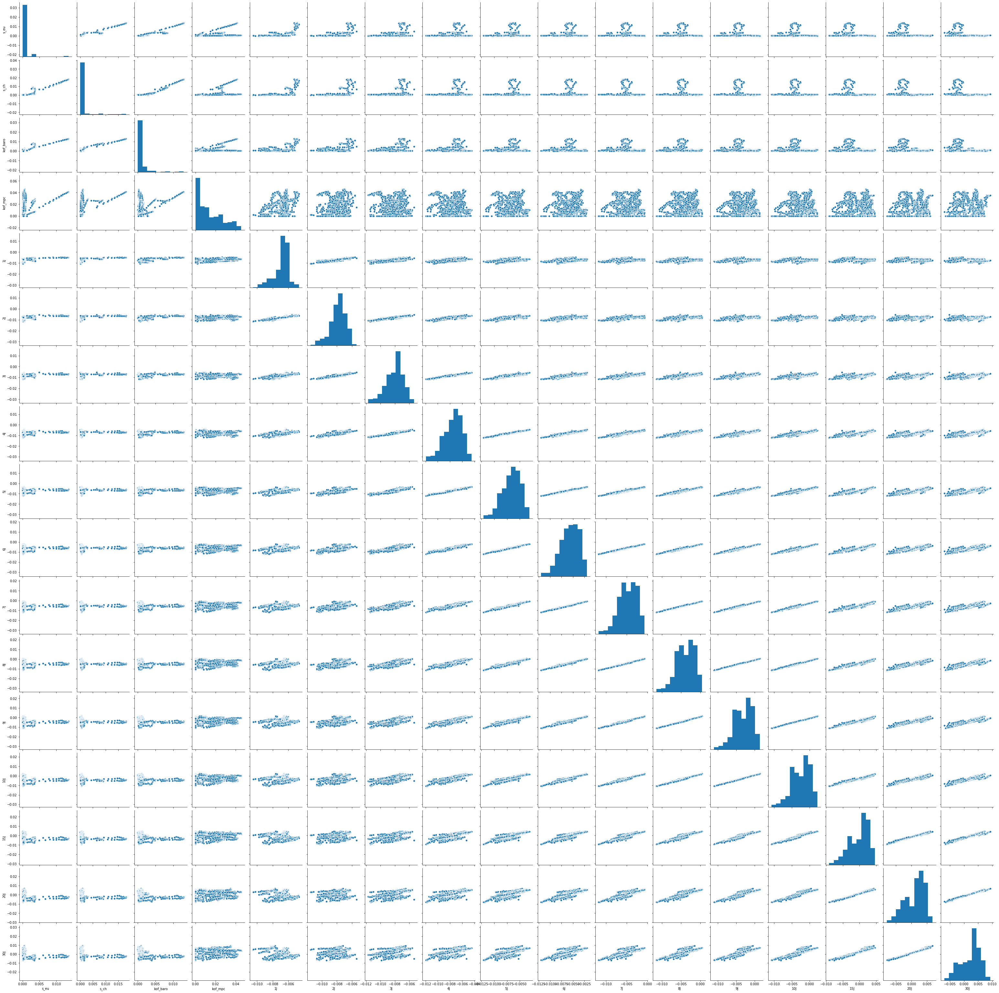

In [21]:
plt.figure(figsize = (12,10))
sns.pairplot(rolling_vol(df_5year,30))

### Rolling mean 

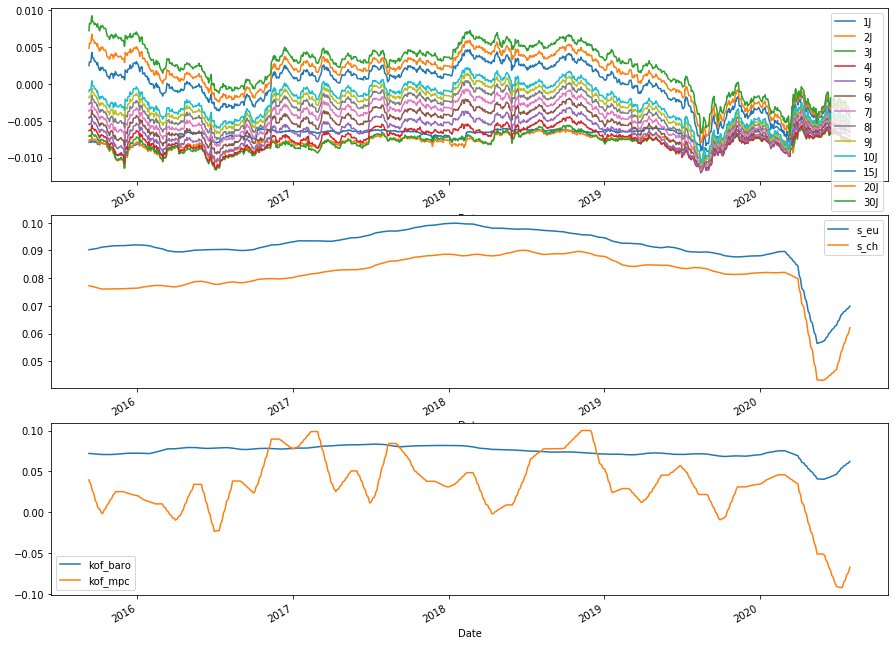

<Figure size 720x432 with 0 Axes>

In [22]:
yields_plot(rolling_mean(df_5year,30))

<Figure size 864x720 with 0 Axes>

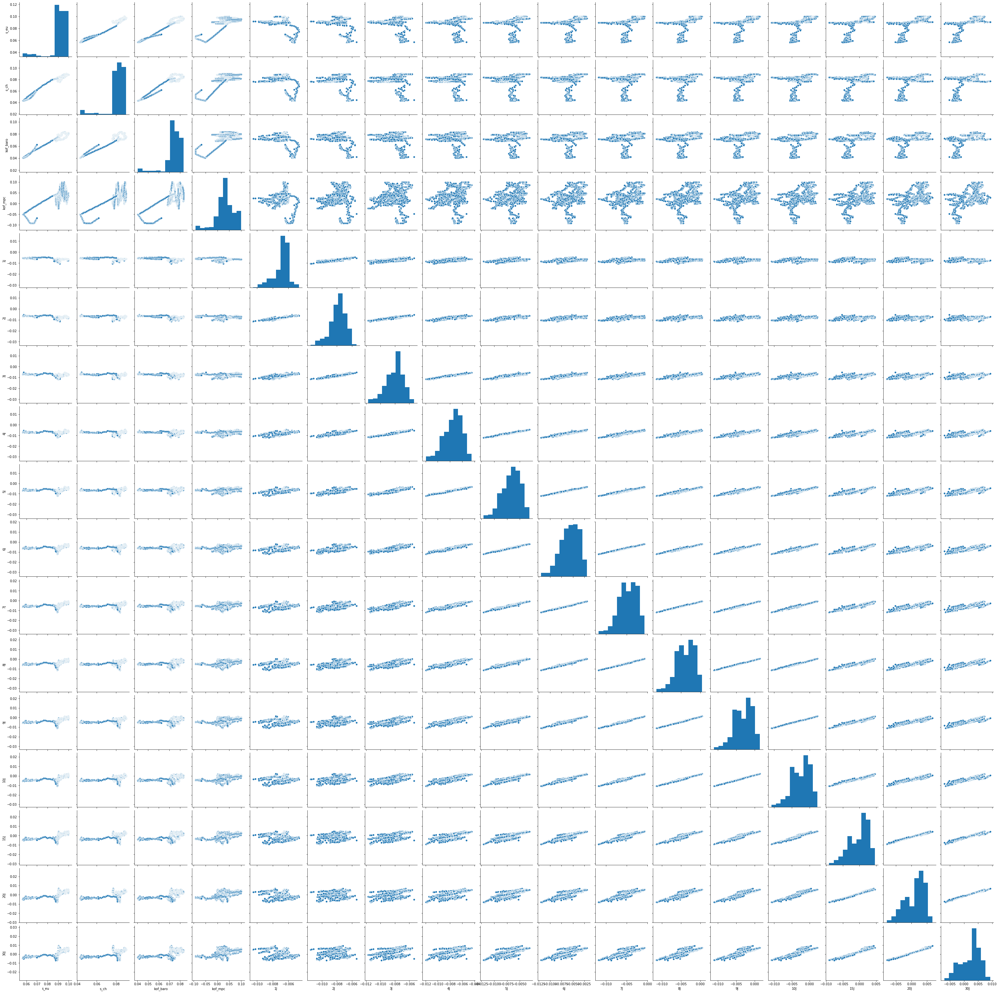

In [23]:
plt.figure(figsize = (12,10))
sns.pairplot(rolling_mean(df_5year,30))

### Rolling max

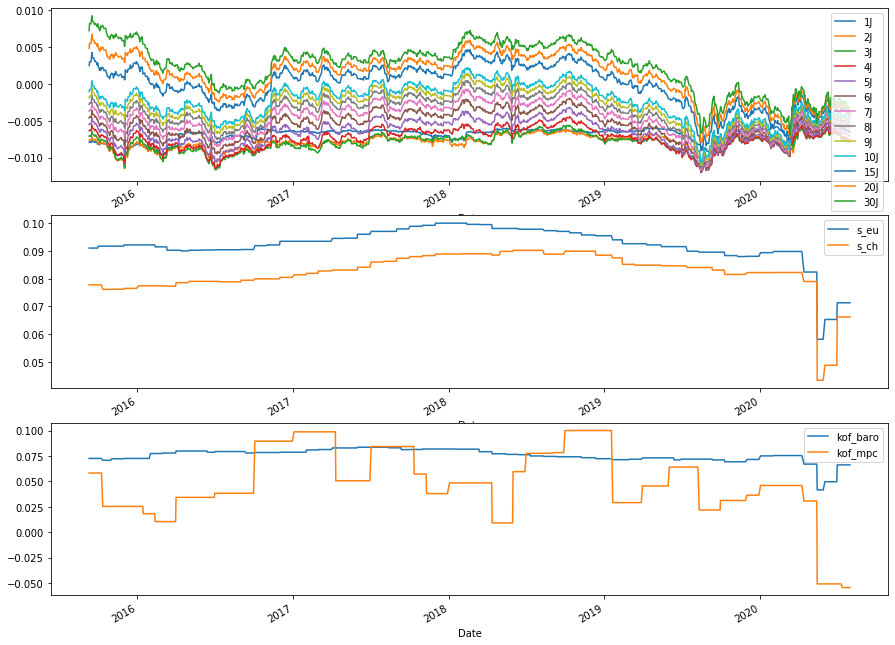

<Figure size 720x432 with 0 Axes>

In [24]:
yields_plot(rolling_max(df_5year,30))

<Figure size 864x720 with 0 Axes>

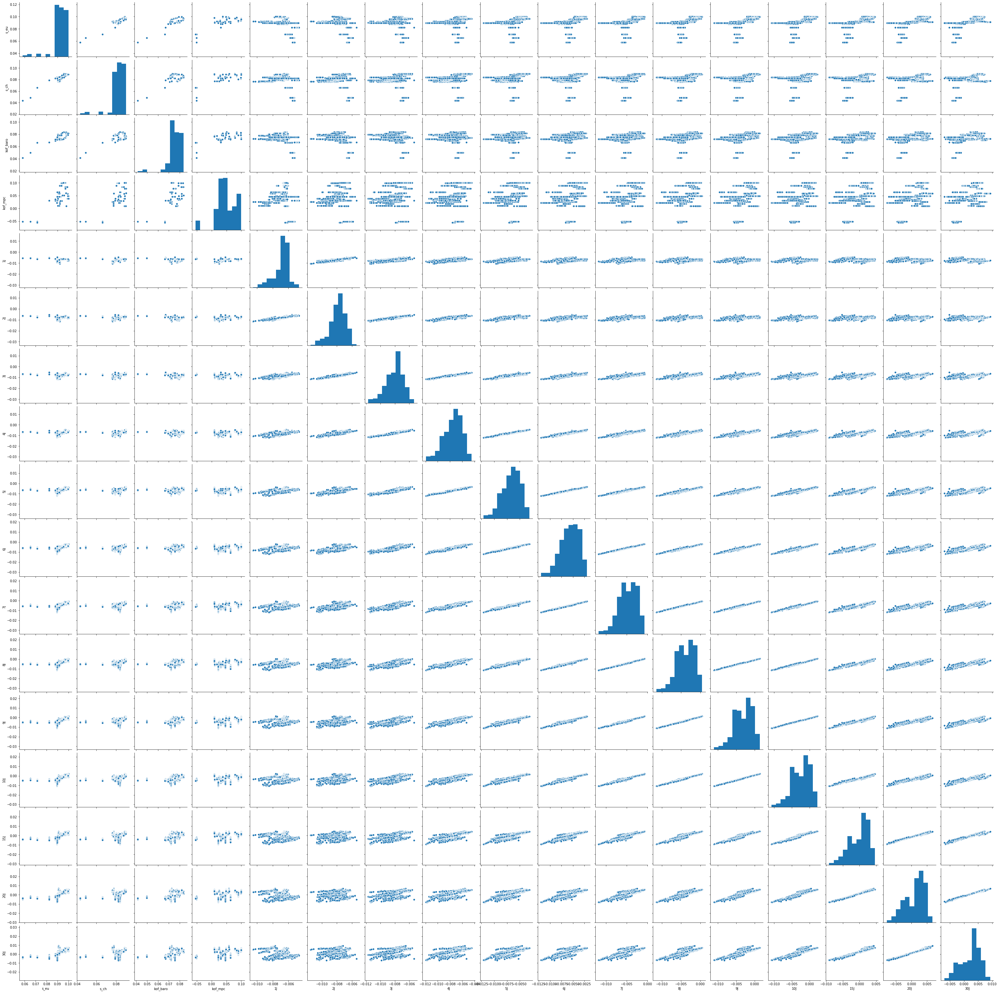

In [25]:
plt.figure(figsize = (12,10))
sns.pairplot(rolling_max(df_5year,30))

### Rolling min

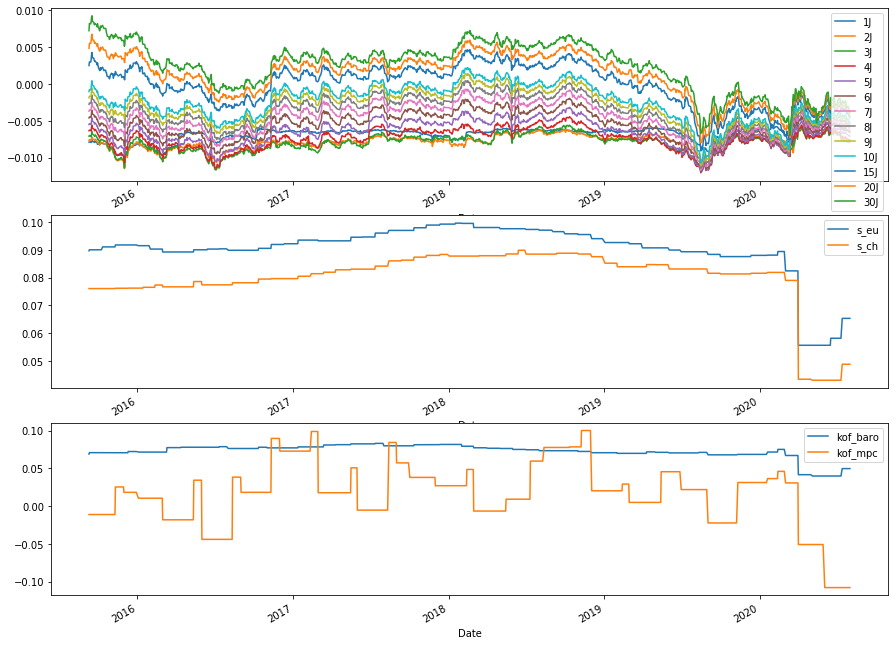

<Figure size 720x432 with 0 Axes>

In [26]:
yields_plot(rolling_min(df_5year,30))

<Figure size 864x720 with 0 Axes>

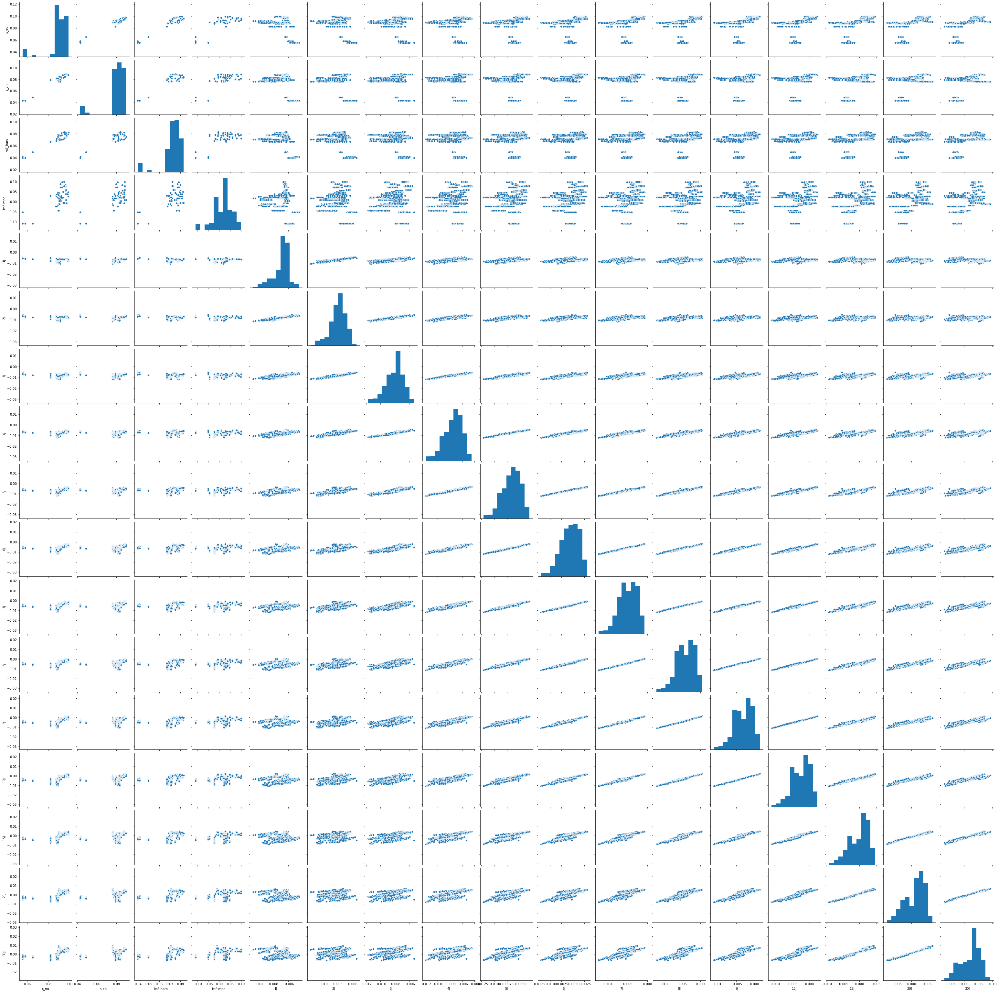

In [27]:
plt.figure(figsize = (12,10))
sns.pairplot(rolling_min(df_5year,30))

## Nelson Siegel Swensson shapes parameters

In [28]:
# !pip install nelson_siegel_svensson

In [29]:
from nelson_siegel_svensson.calibrate import calibrate_ns_ols

In [30]:
def nelson_para(yields):
    t =  np.array([1.0, 2.0, 3.0, 4.0, 5.0, 6.0,7.0, 8.0, 9.0, 10.0, 15.0, 20.0,30.0])
    curve, status = calibrate_ns_ols(t, yields, tau0 = 1.0)  # starting value of 1.0 for the optimization of tau
    p = np.array([curve.beta0, curve.beta1,curve.beta2, curve.tau])
    return p
    

In [31]:
nelson_df = (df.iloc[:,4:].T).apply(nelson_para).T

In [32]:
nelson_df.columns = ['beta0', 'beta1', 'beta2', 'tau']

In [33]:
 new_df = nelson_df.join(df)

In [34]:

def rolling_mean(df,freq):
    df2 = (df.iloc[:,0:8].rolling(freq).mean().copy()).dropna()
    return df2.join(df.iloc[:,8:])   

def rolling_max(df,freq):
    df2 = (df.iloc[:,0:8].rolling(freq).max().copy()).dropna()
    return df2.join(df.iloc[:,8:])   

def rolling_min(df,freq):
    df2 = (df.iloc[:,0:8].rolling(freq).min().copy()).dropna()
    return df2.join(df.iloc[:,8:])   

def rolling_growth(df,freq):
    df2 = (df.iloc[:,0:8].rolling(freq).apply(lambda x: (x.iloc[-1] - x.iloc[0])/x.iloc[0]).copy()).dropna()
    return df2.join(df.iloc[:,8:])   

def nl_plot(df):
    
    terms = ['1J', '2J','3J', '4J', '5J', '6J','7J', '8J', '9J', '10J', '15J', '20J', '30J']

    figure, axes = plt.subplots(3,1,figsize=(15,12))
    plt.figure(figsize = (10,6))
    df.loc[:,terms].plot(ax=axes[0])
    df.loc[:,['beta0', 'beta1', 'beta2']].plot(ax=axes[1])
    df.loc[:,['tau']].plot(ax=axes[2])
    plt.show()



In [35]:
df3 = sub_range(new_df,nb_years = 5)

### parameters plots

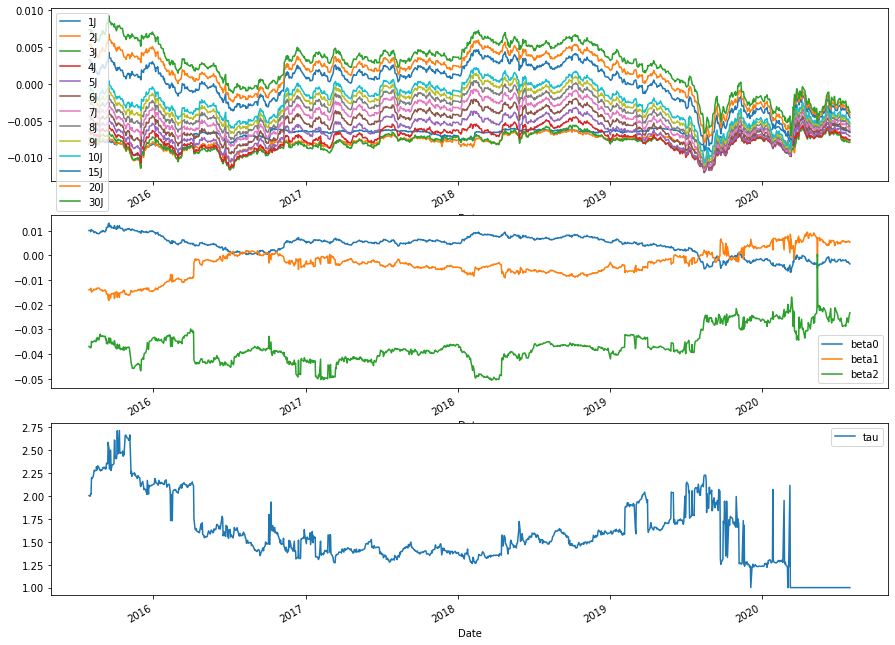

<Figure size 720x432 with 0 Axes>

In [36]:
nl_plot(df3)

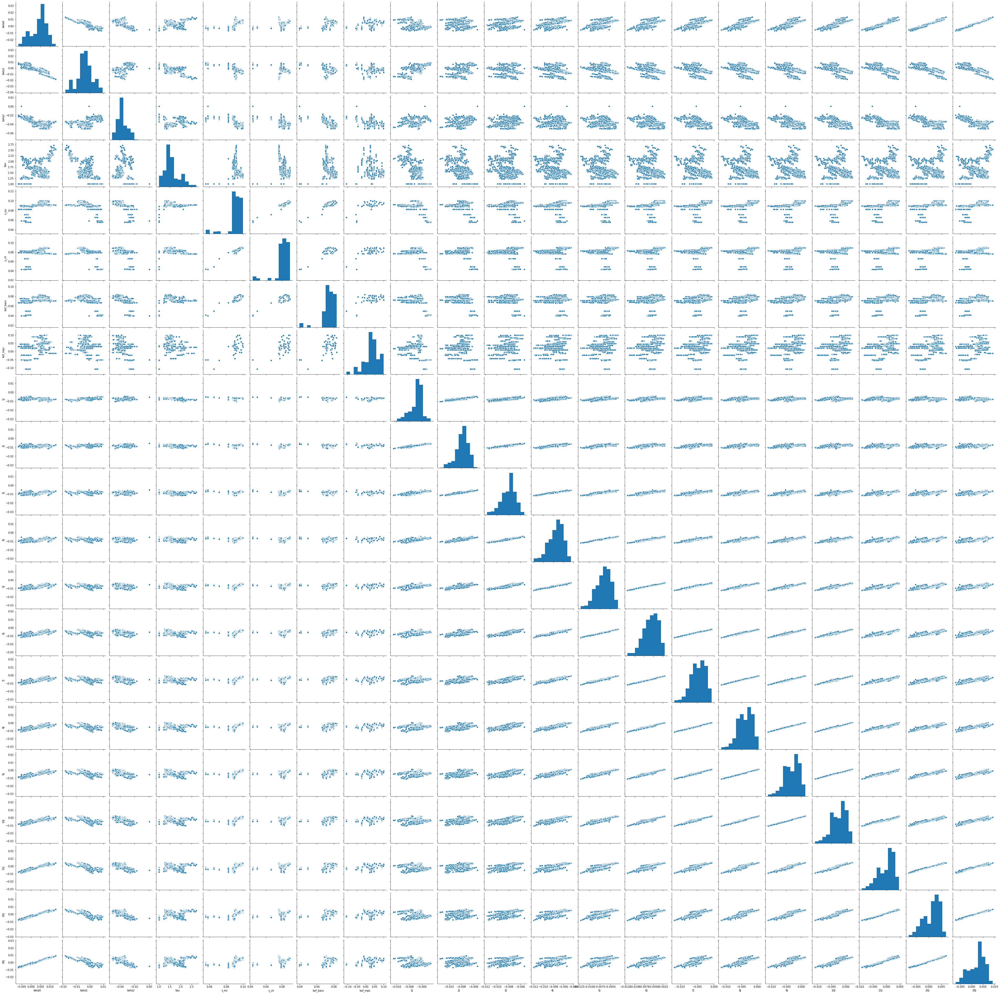

In [37]:
sns.pairplot(df3)

### Rolling mean

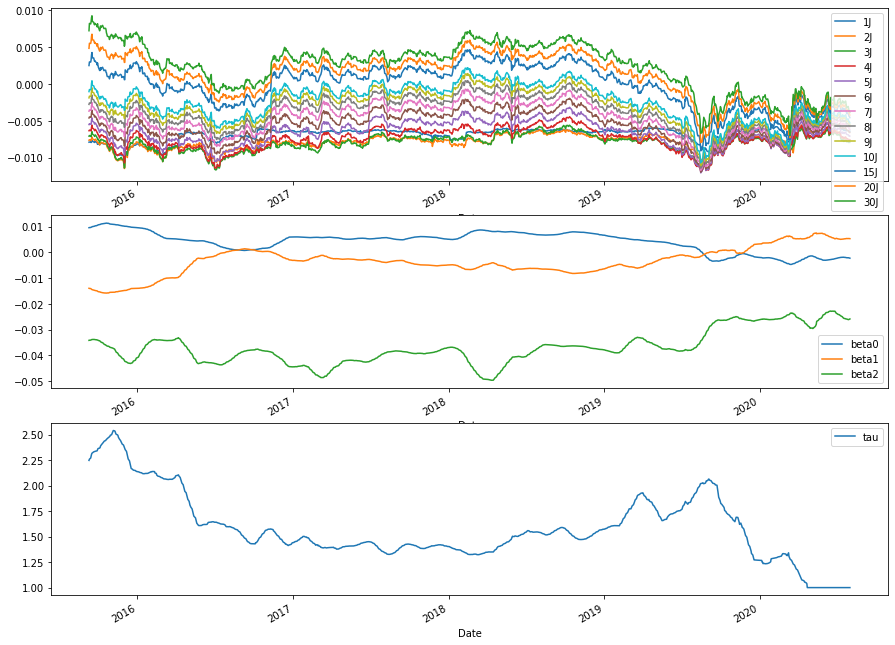

<Figure size 720x432 with 0 Axes>

In [38]:
nl_plot(rolling_mean(df3,30))

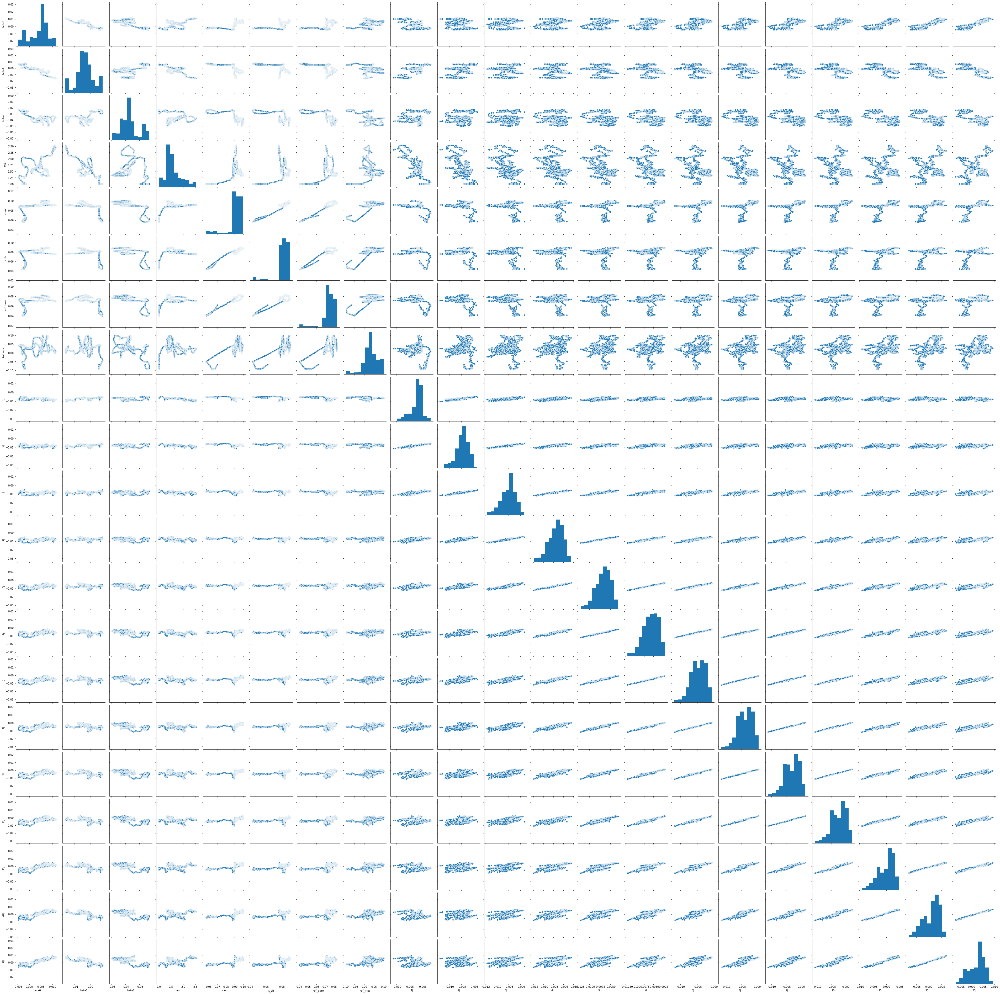

In [39]:
sns.pairplot(rolling_mean(df3,30))

### Rolling growth

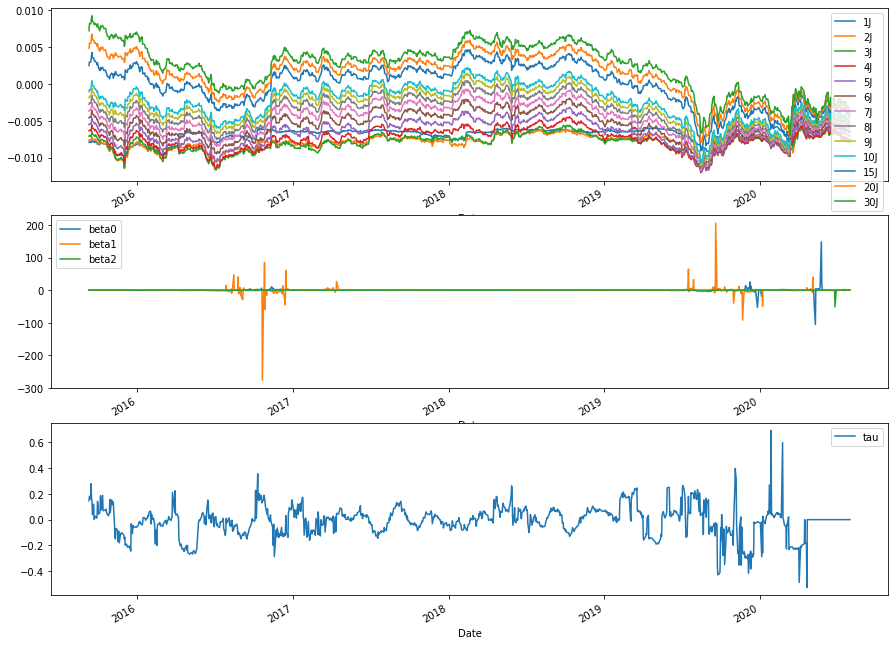

<Figure size 720x432 with 0 Axes>

In [40]:
nl_plot(rolling_growth(df3,30))

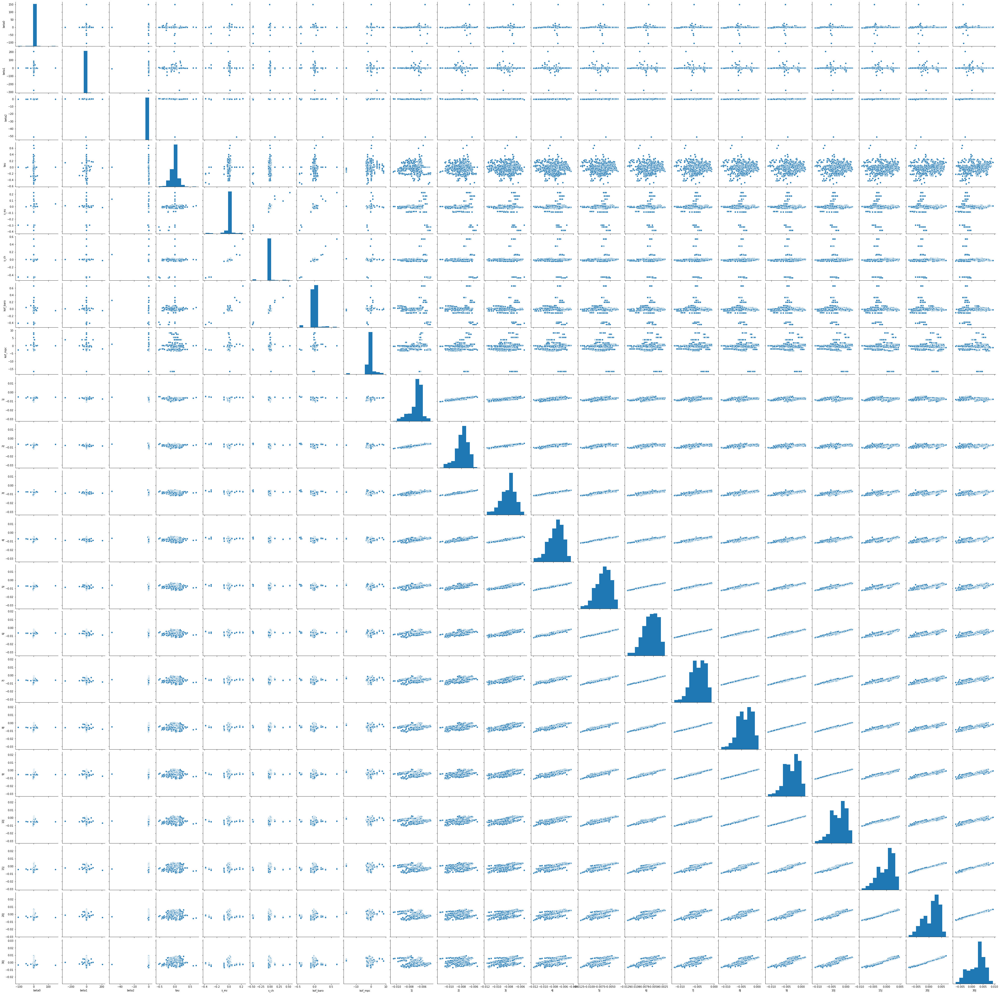

In [41]:
sns.pairplot(rolling_growth(df3,30))

### Rolling max

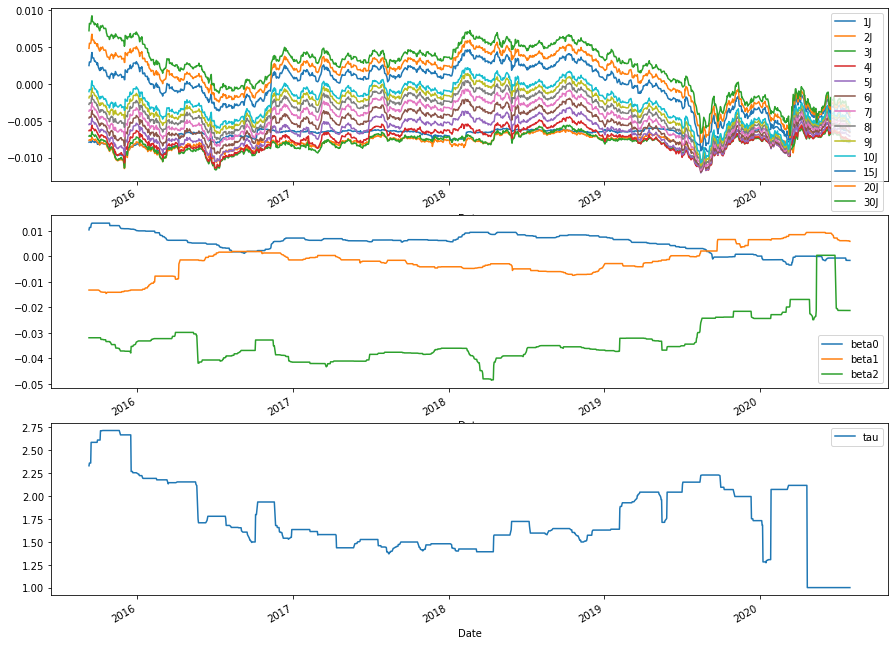

<Figure size 720x432 with 0 Axes>

In [42]:
nl_plot(rolling_max(df3,30))

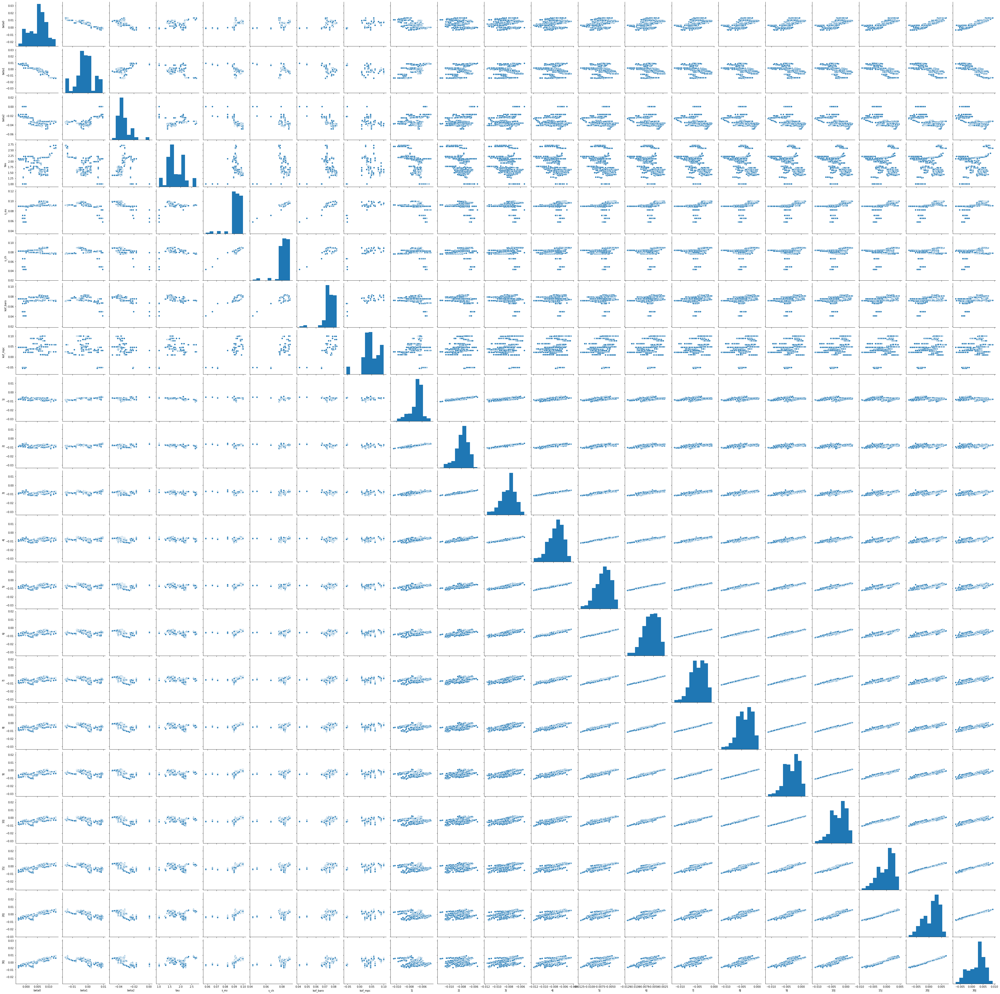

In [43]:
sns.pairplot(rolling_max(df3,30))

### Rolling min

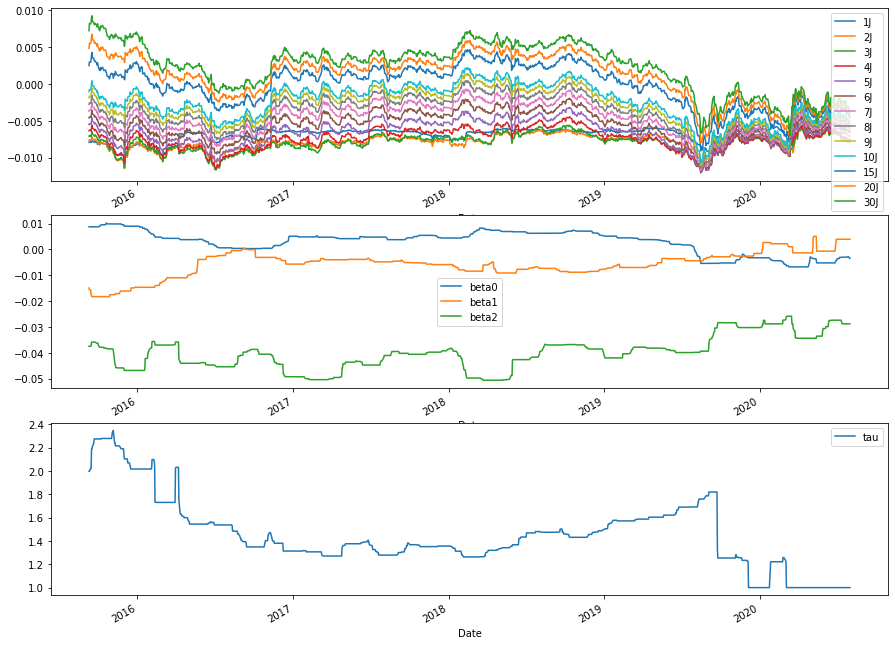

<Figure size 720x432 with 0 Axes>

In [44]:
nl_plot(rolling_min(df3,30))

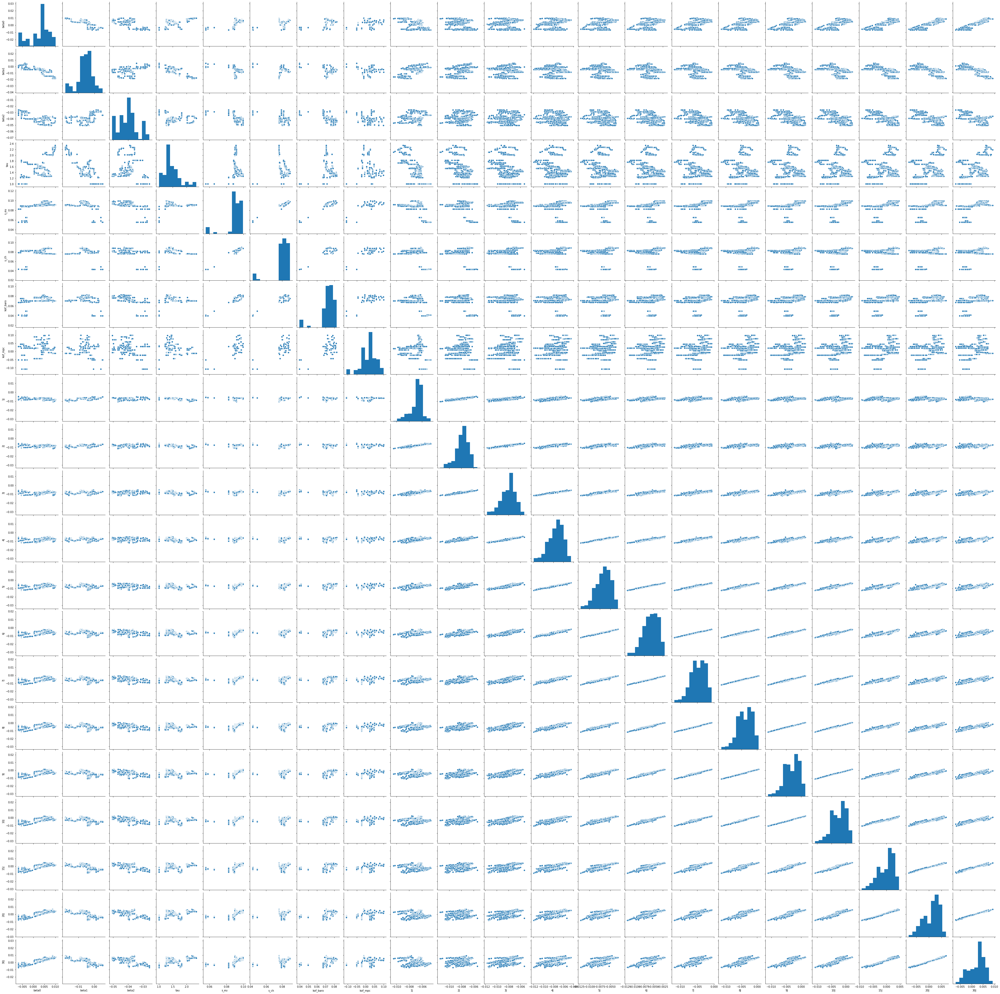

In [45]:
sns.pairplot(rolling_min(df3,30))